# 01_gen_polyrhythm_samples

Este notebook genera **patrones rítmicos polirrítmicos** a partir de modelos entrenados y los convierte en **audio de batería realista**, listo para análisis o exportación.

## Objetivos
- Generar secuencias rítmicas por género musical a partir de un modelo LSTM entrenado.  
- Convertir dichas secuencias en audio reproducible usando un **kit de batería General MIDI (GM)**.  
- Evaluar la **densidad y distribución instrumental** para diagnosticar el desempeño del modelo.  
- Exportar los resultados en formato `.wav` y `.zip` para análisis posterior.

##  Flujo del notebook
1. **Configuración** de rutas y selección del modelo adecuado (dataset_1).  
2. **Reconstrucción** de `id2bitmask` a partir de `bars (dtype=object)` si no está disponible.  
3. **Inferencia**: generación de compases por género usando **muestreo Top-K**.  
4. **Conversión a audio** usando un **kit GM realista** (Kick, Snare, Hi-hat, Toms, Ride, Crash, Percusión).  
5. **Visualización de diagnóstico**: distribución y activaciones por canal.  
6. **Exportación automática** de todos los audios en un **ZIP descargable**.

>  Ejecuta las celdas **en orden (Run All)** sin modificar su secuencia.

## (1) Configuración y rutas

In [22]:

import os, json, math, zipfile
import numpy as np
import tensorflow as tf
import pathlib as P
from IPython.display import Audio, display
import matplotlib.pyplot as plt

# Robustez para PROJECT_ROOT: sube hasta encontrar 'models/final'
def find_project_root(start: P.Path) -> P.Path:
    start = P.Path(start).resolve()
    cur = start
    for _ in range(10):
        if (cur / "models" / "final").exists():
            return cur
        if cur.parent == cur:
            break
        cur = cur.parent
    # Fallbacks seguros
    parts = start.parts
    if len(parts) >= 2 and parts[-1:] == ("src", "notebooks"):
        try:
            return start.parents[1]  # proyecto
        except IndexError:
            pass
    # si no, intenta un nivel arriba
    return start.parent

CWD = P.Path.cwd()
PROJECT_ROOT = find_project_root(CWD)
print("PROJECT_ROOT:", PROJECT_ROOT)

MODELS_DIR = PROJECT_ROOT / "models" / "final"
assert MODELS_DIR.exists(), f"No existe {MODELS_DIR}"

# Selecciona modelo por preferencia
MODEL_PATHS = sorted(list(MODELS_DIR.glob("*.keras")) + list(MODELS_DIR.glob("*.h5")))
assert MODEL_PATHS, "No hay modelos en models/final"
pref = [p for p in MODEL_PATHS if p.name.lower() in ("best.h5","best_1.h5","best_2.h5","best_3.h5")]
MODEL_PATH = pref[0] if pref else MODEL_PATHS[0]
print("Usando modelo:", MODEL_PATH.name)

# Selección de dataset en función del nombre del modelo
def pick_dataset_dir(model_path: P.Path) -> P.Path:
    mn = model_path.name.lower()
    d1 = PROJECT_ROOT / "data" / "processed"
    d2 = d1 / "dataset_2"
    d3 = d1 / "dataset_3"
    if "best_3" in mn or mn.endswith("_3.h5") or model_path.suffix == ".keras":
        for d in (d3, d2, d1):
            if d.exists(): return d
    elif "best_2" in mn or mn.endswith("_2.h5"):
        for d in (d2, d3, d1):
            if d.exists(): return d
    return d1 if d1.exists() else PROJECT_ROOT / "data" / "processed"

DATASET_DIR = pick_dataset_dir(MODEL_PATH)
print("DATASET_DIR:", DATASET_DIR)

VOCAB_PATH = DATASET_DIR / "vocab_topN.json"
if not VOCAB_PATH.exists():
    VOCAB_PATH = DATASET_DIR / "vocab.json"
print("VOCAB_PATH:", VOCAB_PATH)

# Parámetros de generación
GENRES = ["jazz","bossa","samba","hiphop","afrocubano","choro"]
STEPS_PER_BAR = 16
BPM = 100
TEMPERATURE = 1.1
TOP_K = 24
POLY_THRESHOLD = 0.08       # umbral mínimo para aceptar (ajústalo si filtra demasiado)
NUM_SAMPLES_PER_GENRE = 3
BARS_PER_SAMPLE = 4

# Directorio de salida
import time
OUT_ROOT = PROJECT_ROOT / "outputs" / time.strftime("%Y-%m-%d") / "polyrhythm_samples_model1"
AUDIO_DIR = OUT_ROOT / "audio_wav"
AUDIO_DIR.mkdir(parents=True, exist_ok=True)
print("OUT_DIR:", OUT_ROOT)


PROJECT_ROOT: C:\Users\Djcho\Documents\Repositories\Polyrhythmia\model_lstm
Usando modelo: best.h5
DATASET_DIR: C:\Users\Djcho\Documents\Repositories\Polyrhythmia\model_lstm\data\processed
VOCAB_PATH: C:\Users\Djcho\Documents\Repositories\Polyrhythmia\model_lstm\data\processed\vocab.json
OUT_DIR: C:\Users\Djcho\Documents\Repositories\Polyrhythmia\model_lstm\outputs\2025-10-15\polyrhythm_samples_model1


## (2) Cargar vocab y reconstruir `id2bitmask` por **instrumento** (si falta)

In [23]:

# Carga vocab
vocab = {}
if VOCAB_PATH.exists():
    try:
        with open(VOCAB_PATH, "r", encoding="utf-8") as f:
            vocab = json.load(f)
    except Exception:
        vocab = {}

# Intenta leer mapping directo
id2bit = None
for k in ["id2bitmask", "id_to_bitmask", "id2bit"]:
    if k in vocab:
        id2bit = {int(kk): np.array(v, dtype=np.int32).ravel() for kk, v in vocab[k].items()}
        break

I_REAL = None
REST_IDS = []
INSTRUMENT_VOCAB = vocab.get("instrument_vocab", None)

if id2bit is not None:
    I_REAL = int(max(np.array(list(map(len,id2bit.values())))))
    REST_IDS = sorted([tid for tid, bm in id2bit.items() if np.asarray(bm).sum()==0])

print("I_REAL:", I_REAL, "| REST_IDS:", REST_IDS[:5], "...")

# Helpers para reconstrucción por instrumento
def _to_list(x):
    """
    Lista de 'instrumentos' activos en un step.
    - Vector binario -> índices donde hay 1 (canales).
    - Lista/array de enteros -> se toman como 'pitches' GM (valores != 0).
    - Escalar entero != 0 -> [x].
    """
    try:
        arr = np.array(x)
        # Caso bitmask por instrumento
        if arr.ndim >= 1 and np.all(np.isin(arr, [0, 1])) and arr.size > 1:
            flat = arr.ravel()
            return [int(i) for i, v in enumerate(flat) if int(v) == 1]
    except Exception:
        pass

    if isinstance(x, (list, tuple, np.ndarray)):
        vals = []
        for v in np.array(x).ravel():
            try:
                iv = int(v)
                if iv != 0:
                    vals.append(iv)
            except Exception:
                continue
        return vals

    try:
        v = int(x)
        return [v] if v != 0 else []
    except Exception:
        return []


def scan_instrument_vocab_from_bars(bars_obj):
    """Detecta si 'bars' es bitmask (devuelve [0..I-1]) o pitches GM (devuelve lista de pitches)."""
    smp = bars_obj[0, 0]
    try:
        arr = np.array(smp)
        if arr.ndim >= 1 and np.all(np.isin(arr, [0, 1])) and arr.size > 1:
            return list(range(int(arr.size)))  # canales 0..I-1
    except Exception:
        pass

    inst = set()
    N, T = bars_obj.shape
    for i in range(N):
        for t in range(T):
            for v in _to_list(bars_obj[i, t]):
                inst.add(int(v))
    return sorted(inst)


def bars_to_3d_with_vocab(bars_obj, vocab):
    """bars(object) -> (N,T,I) multi-hot. Si vocab son índices: usa índices; si son pitches: mapea por pitch."""
    idx = {p: i for i, p in enumerate(vocab)}
    N, T = bars_obj.shape
    I = len(vocab)
    BM = np.zeros((N, T, I), dtype=np.int8)

    is_index_vocab = all(isinstance(p, (int, np.integer)) and p < 32 for p in vocab)

    for i in range(N):
        for t in range(T):
            lst = _to_list(bars_obj[i, t])
            if is_index_vocab:
                for j in lst:                 # j ya es índice de canal
                    if 0 <= j < I:
                        BM[i, t, j] = 1
            else:
                for pitch in lst:             # mapea pitch -> canal por vocab
                    jj = idx.get(int(pitch), None)
                    if jj is not None:
                        BM[i, t, jj] = 1
    return BM

def load_any_bitmask_3d(DATASET_DIR):
    """Devuelve BM (N,T,I) si 'bars' son bitmasks; si son pitches, retorna None."""
    for name in ["train_bitmasks.npz", "validation_bitmasks.npz", "test_bitmasks.npz"]:
        p = DATASET_DIR / name
        if p.exists():
            with np.load(p, allow_pickle=True) as z:
                bars = z["bars"]
            s = bars[0, 0]
            arr = np.array(s)
            if arr.ndim >= 1 and np.all(np.isin(arr, [0, 1])) and arr.size > 1:
                vocab_idx = list(range(int(arr.size)))
                return bars_to_3d_with_vocab(bars, vocab_idx)
    return None


def infer_gm_map_from_bitmask_dataset(DATASET_DIR):
    """
    Heurística: a partir de BM (N,T,I)
      - HH = canal con mayor densidad (cuenta/total).
      - SN = mayor energía en 'backbeats' (steps 4 y 12).
      - KD = mayor energía en beats fuertes (0 y 8), excluyendo HH/SN.
    Devuelve dict con indices y lista 'gm_per_index' de pitches GM por canal.
    """
    BM = load_any_bitmask_3d(DATASET_DIR)
    if BM is None:
        return None

    N, T, I = BM.shape
    # Métricas por canal
    density = BM.mean(axis=(0, 1))
    beats = [0, 4, 8, 12]
    backbeats = [4, 12]
    onbeat  = BM[:, beats, :].sum(axis=(0, 1))
    back    = BM[:, backbeats, :].sum(axis=(0, 1))

    hh_idx = int(np.argmax(density))
    mask = np.ones(I, dtype=bool); mask[hh_idx] = False
    sn_idx = int(np.argmax(np.where(mask, back, -1)))
    mask[sn_idx] = False
    kd_idx = int(np.argmax(np.where(mask, onbeat, -1)))

    # Construir pitch GM por canal
    rota = [41,43,45,47,48,51,49,37,46,57,59,54]  # toms/ride/crash/perc
    gm = [0]*I
    if 0 <= kd_idx < I: gm[kd_idx] = 36
    if 0 <= sn_idx < I: gm[sn_idx] = 38
    if 0 <= hh_idx < I: gm[hh_idx] = 42
    rest = [j for j in range(I) if j not in (kd_idx, sn_idx, hh_idx)]
    for k, j in enumerate(rest):
        gm[j] = rota[k % len(rota)]

    print(f"[GM inferido] KD={kd_idx}, SN={sn_idx}, HH={hh_idx}")
    return {"kd": kd_idx, "sn": sn_idx, "hh": hh_idx, "gm_per_index": gm}

GM_MAP_BY_INDEX = infer_gm_map_from_bitmask_dataset(DATASET_DIR)


def rebuild_id2bit_from_dataset1(DATASET_DIR, VOCAB_PATH):
    pairs=[]
    cand=[(DATASET_DIR/"train.npz", DATASET_DIR/"train_bitmasks.npz"),
          (DATASET_DIR/"validation.npz", DATASET_DIR/"validation_bitmasks.npz"),
          (DATASET_DIR/"test.npz", DATASET_DIR/"test_bitmasks.npz")]
    for tok_p,bm_p in cand:
        if tok_p.exists() and bm_p.exists(): pairs.append((tok_p,bm_p))
    assert pairs, f"No hay pares tokens/bitmasks en {DATASET_DIR}"
    vocab_inst=[]
    for _,bm_p in pairs:
        with np.load(bm_p, allow_pickle=True) as z:
            assert "bars" in z, f"{bm_p.name} no tiene 'bars'"
            bars=z["bars"]; assert bars.ndim==2 and bars.dtype==object
            vocab_inst = sorted(set(vocab_inst)|set(scan_instrument_vocab_from_bars(bars)))
    print(f"[INFO] instrument_vocab len={len(vocab_inst)}: {vocab_inst[:12]} ...")
    agg={}
    for tok_p,bm_p in pairs:
        with np.load(tok_p, allow_pickle=True) as dt:
            TOK = dt["X_tokens"] if "X_tokens" in dt else dt[list(dt.keys())[0]]
            assert TOK.ndim==2
        with np.load(bm_p, allow_pickle=True) as db:
            bars=db["bars"]
        BM = bars_to_3d_with_vocab(bars, vocab_inst)
        assert TOK.shape[:2]==BM.shape[:2]
        import collections
        N,T,I = BM.shape
        buckets=collections.defaultdict(collections.Counter)
        tok_flat=TOK.reshape(-1); bm_flat=BM.reshape(-1,I)
        for tok,bm in zip(tok_flat,bm_flat):
            key=tuple(bm.astype(int).tolist())
            buckets[int(tok)][key]+=1
        for tok,ctr in buckets.items():
            bitmask_tuple,_ = ctr.most_common(1)[0]
            vec=np.array(bitmask_tuple, dtype=np.int32)
            if tok not in agg: agg[tok]=vec
            else:
                if vec.size>agg[tok].size: agg[tok]=np.pad(agg[tok], (0,vec.size-agg[tok].size))
                elif vec.size<agg[tok].size: vec=np.pad(vec, (0,agg[tok].size-vec.size))
    # persistir
    try:
        with open(VOCAB_PATH,"r",encoding="utf-8") as f: vj=json.load(f)
    except Exception:
        vj={}
    vj["id2bitmask"]={str(k):v.astype(int).tolist() for k,v in agg.items()}
    vj["instrument_vocab"]=vocab_inst
    with open(VOCAB_PATH,"w",encoding="utf-8") as f: json.dump(vj,f,ensure_ascii=False,indent=2)
    print(f"[OK] Guardado id2bitmask en {VOCAB_PATH.name}")
    return agg, vocab_inst

if id2bit is None:
    id2bit, INSTRUMENT_VOCAB = rebuild_id2bit_from_dataset1(DATASET_DIR, VOCAB_PATH)
    I_REAL = int(max(np.array(list(map(len,id2bit.values())))))
    REST_IDS = sorted([tid for tid,bm in id2bit.items() if np.asarray(bm).sum()==0])
    print("I_REAL:", I_REAL, "| REST_IDS:", REST_IDS[:5], "...")
else:
    if INSTRUMENT_VOCAB is None:
        try:
            with open(VOCAB_PATH,"r",encoding="utf-8") as f: vj=json.load(f)
            INSTRUMENT_VOCAB = vj.get("instrument_vocab", None)
        except Exception:
            INSTRUMENT_VOCAB = None


I_REAL: 1 | REST_IDS: [0, 7, 8, 9, 15] ...


## (3) Utilidades de inferencia y generación

In [24]:

def safe_load_model(path: P.Path):
    try:
        return tf.keras.models.load_model(path)
    except Exception:
        return tf.keras.models.load_model(path, compile=False)

def get_input_last_dim(model, idx):
    if idx is None: return None
    try:
        shp = model.inputs[idx].shape
    except Exception:
        shp = model.input_shape[idx]
    return int(shp[-1])

def infer_model_signature(model, T_expected=None, S_expected=None):
    # Devuelve índices de entradas: tokens, pos, style si existen
    sig = {"tokens": None, "pos": None, "style": None}
    inputs = model.inputs if isinstance(model.inputs, (list,tuple)) else [model.inputs]
    for i, x in enumerate(inputs):
        shp = tuple(int(d) if d is not None else -1 for d in x.shape)
        last = shp[-1] if len(shp)>1 else None
        if shp[-1] is not None and (last==T_expected or len(shp)==2):
            # por nombre
            name = (getattr(x, "name", "") or "").lower()
            if "style" in name: sig["style"]=i
            elif "pos" in name or "position" in name: sig["pos"]=i
            else: sig["tokens"]=i
    # Fall-backs por cantidad
    if len(inputs)==3 and sig["tokens"] is None: sig["tokens"]=0; sig["pos"]=1; sig["style"]=2
    if len(inputs)==2 and sig["tokens"] is None: sig["tokens"]=0; sig["pos"]=1
    if len(inputs)==1 and sig["tokens"] is None: sig["tokens"]=0
    return sig

def align_style_vector(vec, expected_dim):
    if vec is None or expected_dim is None: return None
    v = np.array(vec, dtype=np.float32).ravel()
    if v.size == expected_dim: return v
    if v.size < expected_dim:
        return np.pad(v, (0, expected_dim - v.size))
    return v[:expected_dim]

def get_model_vocab_size(model):
    out = model.output_shape[-1]
    return int(out)

def predict_batch(model, X, pos=None, Z=None):
    sig = infer_model_signature(model, T_expected=X.shape[1], S_expected=(None if Z is None else Z.shape[-1]))
    feeds = []
    if sig["tokens"] is not None: feeds.append(X)
    if sig["pos"] is not None and pos is not None: feeds.append(pos)
    if sig["style"] is not None and Z is not None: feeds.append(Z)
    return model(feeds, training=False).numpy()

rng = np.random.default_rng(123)

def top_k_sample(p, k=8, temperature=1.0):
    p = np.asarray(p, dtype=np.float64)
    p = p / (p.sum() + 1e-8)
    if k < len(p):
        idx = np.argpartition(p, -k)[-k:]
        sub = p[idx] / (p[idx].sum() + 1e-8)
        return int(rng.choice(idx, p=sub))
    return int(rng.choice(len(p), p=p))

def generate_bar(model, T=16, style_vec=None, temperature=1.0, top_k=16):
    sig = infer_model_signature(model, T_expected=T, S_expected=(len(style_vec) if style_vec is not None else None))
    V = get_model_vocab_size(model)
    x = np.zeros((T,), dtype=np.int32)

    # inputs
    pos = np.arange(1, T+1, dtype=np.int32)[None, :]
    Z = None
    if sig["style"] is not None and style_vec is not None:
        exp = get_input_last_dim(model, sig["style"])
        Z = align_style_vector(style_vec, exp)[None, :].astype(np.float32)

    for t in range(T):
        X = x[None, :]
        y = predict_batch(model, X, pos=pos, Z=Z)  # (1,T,V)
        probs_t = y[0, t, :]
        tok = top_k_sample(probs_t, k=top_k, temperature=temperature)
        x[t] = min(tok, V-1)
    return x


## (4) Métricas y síntesis de audio (GM)

In [25]:

def tokens_to_multihot(seq_ids: np.ndarray, id2bitmask: dict, I: int = None) -> np.ndarray:
    T = int(seq_ids.shape[0])
    if I is None:
        I = max((np.array(v).size for v in id2bitmask.values()), default=0)
    M = np.zeros((T, I), dtype=np.int32)
    for t in range(T):
        bm = id2bitmask.get(int(seq_ids[t]), None)
        if bm is not None:
            arr = np.array(bm, dtype=np.int32).ravel()
            L = min(I, arr.size); M[t, :L] = arr[:L]
    return M

def polyrhythm_score(M: np.ndarray) -> float:
    # Sencilla: cuantos canales activos distintos hay por step, normalizado
    T, I = M.shape
    per_step = (M.sum(axis=1) > 0).astype(np.float32)  # hubo golpe
    density = per_step.mean()
    active_channels = (M.sum(axis=0) > 0).sum() / max(1, I)
    return float(0.5 * density + 0.5 * active_channels)

# GM mapping y sintetizador
GM_KICKS  = {35,36}
GM_SNARES = {38,40}
GM_HHC    = {42}
GM_HHO    = {46}
GM_TOMS   = {41,43,45,47,48,50}
GM_RIDE   = {51,59}
GM_CRASH  = {49,57}
GM_PERC   = {37,39,44,53,54,55,56,58}

def map_roles_from_vocab(vocab):
    kd = sn = hh = None; others=[]
    for j,p in enumerate(vocab):
        if kd is None and p in GM_KICKS:  kd=j; continue
        if sn is None and p in GM_SNARES: sn=j; continue
        if hh is None and (p in GM_HHC or p in GM_HHO): hh=j; continue
        others.append(j)
    return kd, sn, hh, others

# Si no tenemos 'pitches' GM en INSTRUMENT_VOCAB (p.ej. es bitmask 0..I-1),
# creamos un mapeo heurístico a GM para que suene como kit real.
DEFAULT_GM_MAP = [36, 38, 42, 41, 43, 45, 51, 49, 37]  # KD, SN, HH, toms, ride, crash, perc...

def make_gm_vocab_for_indices(I):
    gm = []
    base = DEFAULT_GM_MAP
    for k in range(I):
        gm.append(base[k % len(base)])
    return gm

def synth_drum_audio(M, bpm=100, sr=44100):
    sec_per_beat = 60.0 / bpm
    step_dur = sec_per_beat / 4.0
    T,I = M.shape
    length = int((T*step_dur)*sr) + sr
    y = np.zeros(length, dtype=np.float32)

    def env(t, atk, dec):
        a = np.minimum(1.0, t/atk); d = np.maximum(0.0, 1.0 - (t-atk)/dec)
        return np.clip(np.minimum(a,d), 0.0, 1.0)

    def add_sine(buf,f0,start,dur,amp=0.5,atk=0.002,dec=0.15):
        n = int(dur*sr); t=np.arange(n)/sr; e=env(t,atk,dec)
        w = amp*e*np.sin(2*np.pi*f0*t)
        end=min(len(buf), start+n); buf[start:end]+=w[:end-start]

    def add_noise(buf,start,dur,amp=0.4,atk=0.001,dec=0.08,hp=False):
        n=int(dur*sr); t=np.arange(n)/sr; e=env(t,atk,dec)
        noise=np.random.randn(n).astype(np.float32)
        if hp: noise=np.concatenate([[0], noise[1:]-0.98*noise[:-1]])
        w=amp*e*noise; end=min(len(buf), start+n); buf[start:end]+=w[:end-start]

    # Determinar 'vocab_eff' (pitches GM por canal) a usar en audio:
    vocab_eff = None
    if GM_MAP_BY_INDEX and isinstance(GM_MAP_BY_INDEX.get("gm_per_index", None), list):
        vocab_eff = GM_MAP_BY_INDEX["gm_per_index"]             # mapeo inferido canal->GM
    elif INSTRUMENT_VOCAB and any(35 <= int(p) <= 81 for p in INSTRUMENT_VOCAB):
        vocab_eff = INSTRUMENT_VOCAB                            # ya son pitches GM
    else:
        vocab_eff = make_gm_vocab_for_indices(I)                # fallback redondo

    # Índices de roles a partir de vocab_eff (pitches GM)
    kd_idx, sn_idx, hh_idx, other_idxs = map_roles_from_vocab(vocab_eff)

    for t in range(T):
        start=int(t*step_dur*sr)
        if kd_idx is not None and M[t,kd_idx]==1: add_sine(y,60.0,start,0.10,amp=0.9,atk=0.002,dec=0.10)
        if sn_idx is not None and M[t,sn_idx]==1: add_noise(y,start,0.12,amp=0.6,atk=0.002,dec=0.12,hp=True)
        if hh_idx is not None and M[t,hh_idx]==1: add_noise(y,start,0.04,amp=0.35,atk=0.001,dec=0.04,hp=True)
        for j in other_idxs:
            if j in (kd_idx,sn_idx,hh_idx) or M[t,j]==0: continue
            p = vocab_eff[j] if (vocab_eff and j < len(vocab_eff)) else 0
            if p in GM_TOMS:   add_sine(y,120.0+10*(j%5), start,0.10,amp=0.5,atk=0.003,dec=0.10)
            elif p in GM_RIDE: add_sine(y,420.0,start,0.25,amp=0.3,atk=0.002,dec=0.25)
            elif p in GM_CRASH:add_noise(y,start,0.30,amp=0.3,atk=0.002,dec=0.30,hp=True)
            else:              add_noise(y,start,0.06,amp=0.25,atk=0.001,dec=0.06,hp=True)
    y /= max(1e-4, np.max(np.abs(y)))
    return sr, y


## (5) Diagnóstico rápido de canales

In [26]:

def diagnose_channels(M_list):
    # M_list: lista de matrices (T,I)
    if not M_list: 
        print("Nada que diagnosticar todavía.")
        return
    M_all = np.concatenate(M_list, axis=0)
    totals = M_all.sum(axis=0)
    print("Activaciones totales por canal:", totals.tolist())
    plt.figure()
    plt.bar(np.arange(M_all.shape[1]), totals)
    plt.title("Activaciones por canal (global)")
    plt.xlabel("Canal (índice)"); plt.ylabel("Activaciones")
    plt.show()



## (6) Generación por género y exportación


== Género: jazz ==
 ✓ Guardado jazz_sample01_4bars_100bpm.wav  (score=0.609)


 ✓ Guardado jazz_sample02_4bars_100bpm.wav  (score=0.547)


 ✓ Guardado jazz_sample03_4bars_100bpm.wav  (score=0.531)



== Género: bossa ==
 ✓ Guardado bossa_sample01_4bars_100bpm.wav  (score=0.664)


 ✓ Guardado bossa_sample02_4bars_100bpm.wav  (score=0.656)


 ✓ Guardado bossa_sample03_4bars_100bpm.wav  (score=0.586)



== Género: samba ==
 ✓ Guardado samba_sample01_4bars_100bpm.wav  (score=0.703)


 ✓ Guardado samba_sample02_4bars_100bpm.wav  (score=0.625)


 ✓ Guardado samba_sample03_4bars_100bpm.wav  (score=0.602)



== Género: hiphop ==
 ✓ Guardado hiphop_sample01_4bars_100bpm.wav  (score=0.680)


 ✓ Guardado hiphop_sample02_4bars_100bpm.wav  (score=0.633)


 ✓ Guardado hiphop_sample03_4bars_100bpm.wav  (score=0.609)



== Género: afrocubano ==
 ✓ Guardado afrocubano_sample01_4bars_100bpm.wav  (score=0.734)


 ✓ Guardado afrocubano_sample02_4bars_100bpm.wav  (score=0.656)


 ✓ Guardado afrocubano_sample03_4bars_100bpm.wav  (score=0.648)



== Género: choro ==
 ✓ Guardado choro_sample01_4bars_100bpm.wav  (score=0.602)


 ✓ Guardado choro_sample02_4bars_100bpm.wav  (score=0.555)


 ✓ Guardado choro_sample03_4bars_100bpm.wav  (score=0.625)



Resumen: [{'genre': 'jazz', 'file': 'C:\\Users\\Djcho\\Documents\\Repositories\\Polyrhythmia\\model_lstm\\outputs\\2025-10-15\\polyrhythm_samples_model1\\audio_wav\\jazz_sample01_4bars_100bpm.wav', 'score': 0.609375}, {'genre': 'jazz', 'file': 'C:\\Users\\Djcho\\Documents\\Repositories\\Polyrhythmia\\model_lstm\\outputs\\2025-10-15\\polyrhythm_samples_model1\\audio_wav\\jazz_sample02_4bars_100bpm.wav', 'score': 0.546875}, {'genre': 'jazz', 'file': 'C:\\Users\\Djcho\\Documents\\Repositories\\Polyrhythmia\\model_lstm\\outputs\\2025-10-15\\polyrhythm_samples_model1\\audio_wav\\jazz_sample03_4bars_100bpm.wav', 'score': 0.53125}] ... total=18
Activaciones totales por canal: [290]


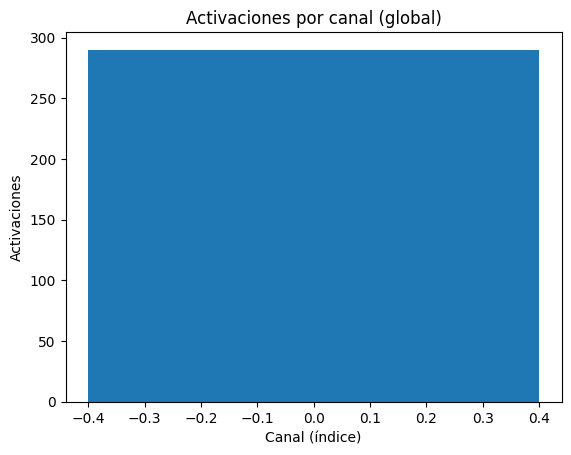

ZIP listo: C:\Users\Djcho\Documents\Repositories\Polyrhythmia\model_lstm\outputs\2025-10-15\polyrhythm_samples_model1\samples_wav.zip


In [27]:

def save_wav(path: P.Path, sr: int, y: np.ndarray):
    import scipy.io.wavfile as wav
    from pathlib import Path
    path = Path(path)
    wav.write(str(path), sr, (y * 32767).astype(np.int16))


# Cargar modelo
model = safe_load_model(MODEL_PATH)
V = get_model_vocab_size(model)

def style_vector_for(genre_name):
    # one-hot si el modelo la espera
    S = 6
    v = np.zeros((S,), dtype=np.float32)
    if genre_name in ["jazz","bossa","samba","hiphop","afrocubano","choro"]:
        idx = ["jazz","bossa","samba","hiphop","afrocubano","choro"].index(genre_name)
        v[idx] = 1.0
    return v

samples_meta = []
accum_M = []

for g in GENRES:
    kept = 0
    attempts = 0
    print(f"\n== Género: {g} ==")
    while kept < NUM_SAMPLES_PER_GENRE and attempts < NUM_SAMPLES_PER_GENRE*12:
        attempts += 1
        style_vec = style_vector_for(g)
        bars = [generate_bar(model, T=STEPS_PER_BAR, style_vec=style_vec,
                             temperature=TEMPERATURE, top_k=TOP_K) for _ in range(BARS_PER_SAMPLE)]
        seq = np.concatenate(bars, axis=0)
        M = tokens_to_multihot(seq, id2bit, I=I_REAL)
        score = polyrhythm_score(M)
        # Guardado por umbral o "mejor esfuerzo" al final
        if score >= POLY_THRESHOLD or attempts >= NUM_SAMPLES_PER_GENRE*12:
            kept += 1
            sr, y = synth_drum_audio(M, bpm=BPM, sr=44100)
            tag = "" if score >= POLY_THRESHOLD else "_BESTEFFORT"
            fname = f"{g}_sample{kept:02d}{tag}_{BARS_PER_SAMPLE}bars_{BPM}bpm.wav"
            fpath = (AUDIO_DIR / fname)
            save_wav(fpath, sr, y)
            samples_meta.append({"genre": g, "file": str(fpath), "score": float(score)})
            accum_M.append(M)
            print(f" ✓ Guardado {fname}  (score={score:.3f})")
            display(Audio(y, rate=sr))
        else:
            print(f"   desc.: score={score:.3f}")
    if kept < NUM_SAMPLES_PER_GENRE:
        print(f"[WARN] Solo se lograron {kept}/{NUM_SAMPLES_PER_GENRE} muestras para {g}.")

print("\nResumen:", samples_meta[:3], "...", f"total={len(samples_meta)}")

# Diagnóstico global tras generar
diagnose_channels(accum_M)

# Empaquetar ZIP
zip_path = OUT_ROOT / "samples_wav.zip"
with zipfile.ZipFile(zip_path, "w", compression=zipfile.ZIP_DEFLATED) as zf:
    for wav in AUDIO_DIR.glob("*.wav"):
        zf.write(wav, arcname=wav.name)
print("ZIP listo:", zip_path)
